## look at the fkb building data set

#### first we simply read it in

In [59]:
import geopandas as gpd
import fiona

# Define the path to the File Geodatabase
gdb_path = r"C:\Users\nilsdi\OneDrive - NTNU\Personal_Python\demolition_footprints\data\raw\FKB_bygning\Basisdata_5001_Trondheim_5972_FKB-Bygning_FGDB.gdb"

# List all layers in the File Geodatabase
layers = fiona.listlayers(gdb_path)

# Print the layers
for layer in layers:
    print(layer)

# Read a layer from the File Geodatabase
gdf_grenser = gpd.read_file(gdb_path, driver='FileGDB', layer='fkb_bygning_grense')
gdf_omrade = gpd.read_file(gdb_path, driver='FileGDB', layer='fkb_bygning_omrade')

# Print the GeoDataFrame
print(gdf_omrade.head())

fkb_bygning_omrade
fkb_bygning_posisjon
fkb_bygning_grense
fkb_bygning_senterlinje


      objtype                               lokalid            datafangstdato  \
0  BygningBru  b9aa84d8-5bfe-47b0-9612-0123b90f8e7d 2007-05-30 00:00:00+00:00   
1  BygningBru  dc0718ee-5a45-4815-b6f1-01a5dd97046f 2014-05-27 00:00:00+00:00   
2  BygningBru  df41dc1b-ba71-4364-8bd5-02158d4ed0ef 2021-08-10 00:00:00+00:00   
3  BygningBru  1c304abc-8e43-445d-9585-02f781268a8f 2013-06-12 00:00:00+00:00   
4  BygningBru  48650131-78ed-4291-9f62-0333b63a5af9 2021-07-26 00:00:00+00:00   

          verifiseringsdato          oppdateringsdato informasjon sluttdato  \
0 2021-08-10 00:00:00+00:00 2023-05-03 15:35:08+00:00        None       NaT   
1 2021-08-10 00:00:00+00:00 2023-05-03 15:35:08+00:00        None       NaT   
2                       NaT 2023-05-03 15:35:08+00:00        None       NaT   
3 2021-08-10 00:00:00+00:00 2023-05-03 15:35:08+00:00        None       NaT   
4                       NaT 2023-05-03 15:35:08+00:00        None       NaT   

  registreringsversjon                

<Axes: >

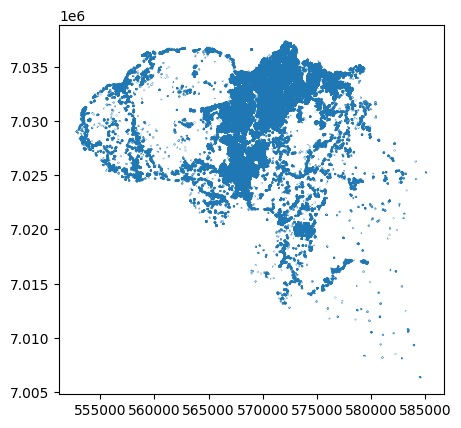

In [60]:
gdf_grenser.plot()

In [61]:
print(gdf_grenser.columns)
# print all objtype possible from the gdf
print(gdf_grenser['objtype'].unique())

Index(['objtype', 'lokalid', 'datafangstdato', 'verifiseringsdato',
       'oppdateringsdato', 'informasjon', 'sluttdato', 'registreringsversjon',
       'navnerom', 'versjonid', 'datafangstmetode', 'noyaktighet', 'synbarhet',
       'datafangstmetodehoyde', 'noyaktighethoyde', 'hoydereferanse', 'medium',
       'tredniva', 'skalavgrensebygning', 'takskjegg', 'lavestegulv',
       'SHAPE_Length', 'geometry'],
      dtype='object')
['BygningBru' 'BygningsavgrensningTiltak' 'Bygningsdelelinje'
 'Bygningslinje' 'Fasadeliv' 'FiktivBygningsavgrensning' 'Grunnmur'
 'Låvebru' 'Mønelinje' 'Takkant' 'TakoverbyggKant' 'Takplatå'
 'TakplatåTopp' 'Taksprang' 'TaksprangBunn' 'TrappBygg' 'Veranda']


### let's look at all the border objects in a small region

In [62]:
import folium
from shapely.geometry import box

# Create a map centered at Trondheim
m = folium.Map(location=[63.4305, 10.3951], zoom_start=13)

# Define the EPSG code of the target CRS
target_crs = 'EPSG:4326'  # replace with the actual EPSG code

# Convert the CRS of the GeoDataFrame
gdf_crs = gdf_grenser.to_crs(target_crs)
bbox = [10.4081, 63.4305, 10.4101, 63.4325]

# Limit the number of rows
gdf_center_hectar= gdf_crs.cx[bbox[0]:bbox[2], bbox[1]:bbox[3]]

# Add a rectangle for the bounding box
folium.GeoJson(box(*bbox), style_function=lambda x: {'color': 'blue', 'fill': False}).add_to(m)

# Add the GeoDataFrame to the map
for _, row in gdf_center_hectar.iterrows():
    folium.GeoJson(row.geometry, style_function=lambda x: {'color': 'red'}).add_to(m)
    #folium.Marker([row.geometry.centroid.y, row.geometry.centroid.x]).add_to(m)

# Display the map
m

the same plot with only the boundaries will be building centric

In [69]:
import folium
from shapely.geometry import box

# Create a map centered at Trondheim
m = folium.Map(location=[63.4305, 10.3951], zoom_start=13)

# Define the EPSG code of the target CRS
target_crs = 'EPSG:4326'  # replace with the actual EPSG code

# Convert the CRS of the GeoDataFrame
gdf_omrade_crs = gdf_omrade.to_crs(target_crs)
bbox = [10.4081, 63.4305, 10.4101, 63.4325]

# Limit the number of rows
gdf_omrade_center_hectar= gdf_omrade_crs.cx[bbox[0]:bbox[2], bbox[1]:bbox[3]]

# Add a rectangle for the bounding box
folium.GeoJson(box(*bbox), style_function=lambda x: {'color': 'blue', 'fill': False}).add_to(m)

# Add the GeoDataFrame to the map
for _, row in gdf_omrade_center_hectar.iterrows():
    folium.GeoJson(row.geometry, style_function=lambda x: {'color': 'red'}).add_to(m)
    #folium.Marker([row.geometry.centroid.y, row.geometry.centroid.x]).add_to(m)

# Display the map
m

## creating a mask from the building shapes

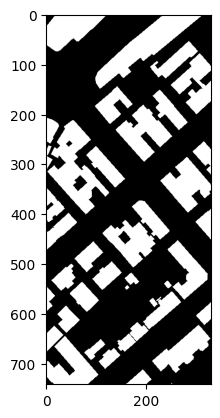

In [81]:
import numpy as np
import rasterio
from rasterio.features import geometry_mask
from rasterio.transform import from_bounds
from matplotlib import pyplot as plt

# Define the bounding box and the resolution
left, bottom, right, top = [10.4081, 63.4305, 10.4101, 63.4325]
# Define the real-world size of a pixel (in meters)
pixel_size = 0.3  # each pixel represents a 0.3m x 0.3m area

# Calculate the scaling factors
scaling_factor_y = 1 / (pixel_size / 111320)  # scaling factor in the y direction
scaling_factor_x = scaling_factor_y * np.cos(np.radians((bottom + top) / 2))  # scaling factor in the x direction

# Calculate the dimensions and the transform of the new GeoTIFF
width = int((right - left) * scaling_factor_x)
height = int((top - bottom) * scaling_factor_y)
transform = from_bounds(left, bottom, right, top, width, height)

# Create an empty array of the same size as the GeoTIFF
data = np.zeros((height, width), dtype=rasterio.uint8)

# For each building
for _, building in gdf_omrade_center_hectar.iterrows():
    # Calculate the pixel coordinates of the building
    building_geom = building.geometry  # assuming building is a GeoDataFrame
    mask = geometry_mask([building_geom], transform=transform, out_shape=(height, width), invert=True)
    
    # Set the corresponding elements of the array to 1
    data[mask] = 1

# Display the data
plt.imshow(data, cmap='gray')
plt.show()

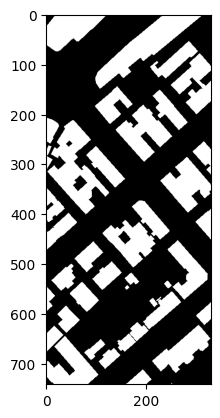

In [95]:
import sys
sys.path.append('../get_label_data')

from get_labels import get_labels, save_labels
bbox = [10.4081, 63.4305, 10.4101, 63.4325]
# Get the labels
labels, transform = get_labels(gdf_omrade, bbox, pixel_size = 0.3)
save_labels(labels, 'test', transform)
plt.imshow(labels, cmap='gray')
plt.show()


In [97]:
import rasterio
from rasterio.transform import from_bounds
from rasterio.features import geometry_mask
import numpy as np

def get_labels(fkb_omrade_gdf, bbox:list, pixel_size:float) -> np.ndarray:
    '''
    Function to get the labels of the buildings in the area of interest

    Arguments:
    fkb_omrade_gdf: GeoDataFrame containing ALL the building footprints for the area
    bbox: list, the bounding box of the area of interest - coordinates in the 
              form [left, bottom, right, top] in WGS84 (EPSG:4326)
    pixel_size: float, the size of the pixel in meters

    Returns:
    data: np.ndarray, labels for buildings in the area (1 for building, 0 for no building)
    '''
    # Define the bounding box and the resolution
    left, bottom, right, top = bbox
    # Calculate the scaling factors
    scaling_factor_y = 1 / (pixel_size / 111320)  # scaling factor in the y direction
    scaling_factor_x = scaling_factor_y * np.cos(np.radians((bottom + top) / 2))  # scaling factor in the x direction

    # Calculate the dimensions and the transform of the new GeoTIFF
    width = int((right - left) * scaling_factor_x)
    height = int((top - bottom) * scaling_factor_y)
    transform = from_bounds(left, bottom, right, top, width, height)

    # Create an empty array of the same size as the GeoTIFF
    data = np.zeros((height, width), dtype=rasterio.uint8)

    # filter the gdf for the selection:
    fkb_omrade_gdf_filtered = fkb_omrade_gdf.cx[bbox[0]:bbox[2], bbox[1]:bbox[3]]

    # For each building
    for _, building in fkb_omrade_gdf_filtered.iterrows():
        # Calculate the pixel coordinates of the building
        building_geom = building.geometry  # assuming building is a GeoDataFrame
        mask = geometry_mask([building_geom], transform=transform, out_shape=(height, width), invert=True)

        # Set the corresponding elements of the array to 1
        data[mask] = 1
    return data

### and now overlay it with a tiff

63.4043876669076 10.372174576238175 63.450943536134666 10.566201451681648
63.4043876669076 10.372174576238175 63.450943536134666 10.566201451681648



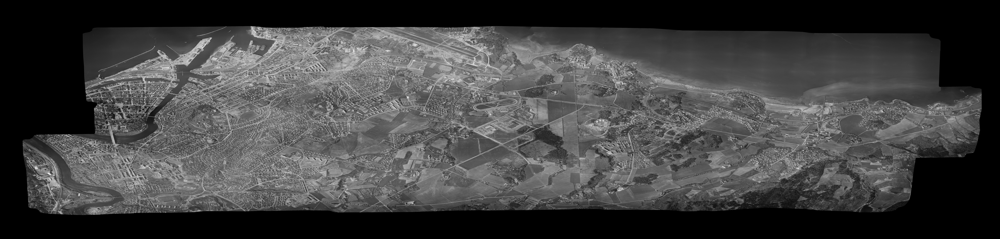

In [63]:
import folium
import rasterio
from rasterio.warp import calculate_default_transform, reproject, Resampling
import numpy as np

# Define the path to the GeoTIFF file
geotiff_path = r"C:\Users\nilsdi\OneDrive - NTNU\Personal_Python\demolition_footprints\data\raw\orthophoto\res_1\strinda 1964\i_lzw_50\Eksport-nib.tif"

# Read the GeoTIFF file
with rasterio.open(geotiff_path) as src:
    # Calculate the transform and dimensions for the new CRS
    transform, width, height = calculate_default_transform(src.crs, 'EPSG:4326', src.width, src.height, *src.bounds)
    
    # Create a new array for the reprojected data
    data = np.empty((src.count, height, width))
    
    # Reproject the data
    reproject(
        source=rasterio.band(src, range(1, src.count + 1)),
        destination=data,
        src_transform=src.transform,
        src_crs=src.crs,
        dst_transform=transform,
        dst_crs='EPSG:4326',
        resampling=Resampling.nearest)

# Get the bounds of the reprojected data
left, bottom, right, top = rasterio.transform.array_bounds(height, width, transform)
print(bottom, left, top, right)
# Create a map centered at the center of the GeoTIFF
m = folium.Map(location=[(bottom +top)/2, (left+right)/2], zoom_start=13)

# Create an image overlay for the GeoTIFF data
image_overlay = folium.raster_layers.ImageOverlay(
    image=data[0],
    bounds=[[bottom, left], [top, right]],
    opacity=0.6)

# Add the image overlay to the map
m.add_child(image_overlay)

# Add a rectangle to the map to represent the bounds of the image overlay
print(bottom, left, top, right)
folium.Rectangle(
    bounds=[[bottom, left], [top, right]],
    color='#ff00ff',
    fill=False,
    fill_color='#ff00ff',
    fill_opacity=0,
).add_to(m)

# Define the EPSG code of the target CRS
target_crs = 'EPSG:4326'  # replace with the actual EPSG code

# Convert the CRS of the GeoDataFrame
gdf_crs = gdf.to_crs(target_crs)
bbox = [10.4081, 63.4305, 10.4101, 63.4325]

# Limit the number of rows
gdf_center_hectar= gdf_crs.cx[bbox[0]:bbox[2], bbox[1]:bbox[3]]

# Add a rectangle for the bounding box
folium.GeoJson(box(*bbox), style_function=lambda x: {'color': 'blue', 'fill': False}).add_to(m)

# Add the GeoDataFrame to the map
for _, row in gdf_center_hectar.iterrows():
    folium.GeoJson(row.geometry, style_function=lambda x: {'color': 'red'}).add_to(m)
    #folium.Marker([row.geometry.centroid.y, row.geometry.centroid.x]).add_to(m)
    
# Display the map
m

## scraps from first tries

In [64]:
gdf_limited = gdf.sample(100)
print(gdf_limited)

              objtype                               lokalid  \
543747  TaksprangBunn  b7097427-b430-4227-ae00-48268a089d35   
311681        Takkant  39eeed17-4ae9-40a4-993c-9ffb7913bc70   
713251        Veranda  2cf74282-56b8-4dc3-8456-bf6e7980fdef   
341053        Takkant  14a910e7-e612-419c-91c1-c4ac7b22cf95   
668751        Veranda  d45ea2d6-30b0-4e27-b0ba-57d1f9208c04   
...               ...                                   ...   
342738        Takkant  a90ed86d-dac3-4612-bfe2-c6ce28dbf636   
300037        Takkant  adaa1cfd-680a-4500-8291-915145cf61a3   
562411  TaksprangBunn  0613d704-f6af-4e3a-a4d7-76f0fbb1e7a8   
584306  TaksprangBunn  29a4422c-91cf-4eda-9b86-ada8b34c90e5   
285174        Takkant  f7289b9f-d816-4d50-994a-7eaff1f14a4d   

                  datafangstdato         verifiseringsdato  \
543747 2014-05-27 00:00:00+00:00 2021-08-10 00:00:00+00:00   
311681 2007-05-30 00:00:00+00:00 2021-08-10 00:00:00+00:00   
713251 2014-05-27 00:00:00+00:00 2021-08-10 00:00:00+00:0

In [65]:
gdf_omrade = gpd.read_file(gdb_path, driver='FileGDB', layer='fkb_bygning_omrade')

In [66]:
gdf_omrade_limited = gdf_omrade.sample(100)
print(gdf_omrade_limited)

             objtype                               lokalid  \
5102    AnnenBygning  f3f7413b-fbaf-436b-99b1-3d0cf3e8d1c5   
81935        Bygning  1eb0491e-7bd0-47b8-94db-4c6153db4223   
68062        Bygning  750f5fac-91e5-472b-b0cd-9ba4dcb1e52c   
12519   AnnenBygning  66017d92-744d-4ed3-bda4-9657ab921a72   
102176   Takoverbygg  0912ec57-5146-4298-8a30-3b83fe5c5768   
...              ...                                   ...   
27967        Bygning  0f4d40cc-7a5e-4d33-ac61-e0ed93372efd   
109923   Takoverbygg  c3c751b2-d31a-40e0-bd75-f2251b0ad69e   
57109        Bygning  6929c5fb-ef8f-4b39-9c36-99e0367a59b2   
83528        Bygning  ecad6a32-1d77-430e-a9ca-07b76691453e   
103146   Takoverbygg  f4badd14-4365-46df-b76b-5292f5ce6ddc   

                  datafangstdato         verifiseringsdato  \
5102   2020-07-08 00:00:00+00:00 2021-08-10 00:00:00+00:00   
81935  2022-12-05 00:00:00+00:00 2020-07-08 00:00:00+00:00   
68062  2022-12-05 00:00:00+00:00 2020-07-08 00:00:00+00:00   
12519  

In [16]:
import folium

# Create a map centered at Trondheim
m = folium.Map(location=[63.4305, 10.3951], zoom_start=13)

# Limit the number of rows
gdf_limited = gdf.sample(100)
# Define the EPSG code of the target CRS
target_crs = 'EPSG:4326'  # replace with the actual EPSG code

# Convert the CRS of the GeoDataFrame
gdf_limited = gdf_limited.to_crs(target_crs)

# Add the GeoDataFrame to the map
for _, row in gdf_limited.iterrows():
    folium.GeoJson(row.geometry, style_function=lambda x: {'color': 'red'}).add_to(m)
    folium.Marker([row.geometry.centroid.y, row.geometry.centroid.x]).add_to(m)

# Display the map
m

In [20]:
import folium

# Create a map centered at Trondheim
m = folium.Map(location=[63.4305, 10.3951], zoom_start=13)

# Define the EPSG code of the target CRS
target_crs = 'EPSG:4326'  # replace with the actual EPSG code

# Convert the CRS of the GeoDataFrame
gdf_crs = gdf_limited.to_crs(target_crs)
bbox = [10.3951, 63.4305, 10.3961, 63.4315]
# Limit the number of rows
gdf_center_hectar= gdf_crs.cx[bbox[0]:bbox[2], bbox[1]:bbox[3]]


# Add the GeoDataFrame to the map
for _, row in gdf_center_hectar.iterrows():
    folium.GeoJson(row.geometry, style_function=lambda x: {'color': 'red'}).add_to(m)
    folium.Marker([row.geometry.centroid.y, row.geometry.centroid.x]).add_to(m)

# Display the map
m

In [23]:
gdf_center_hectar

,objtype,lokalid,datafangstdato,verifiseringsdato,oppdateringsdato,informasjon,sluttdato,registreringsversjon,navnerom,versjonid,...,datafangstmetodehoyde,noyaktighethoyde,hoydereferanse,medium,tredniva,skalavgrensebygning,takskjegg,lavestegulv,SHAPE_Length,geometry


In [104]:
import folium
from shapely.geometry import box

# Create a map centered at Trondheim
m = folium.Map(location=[63.4305, 10.3951], zoom_start=12)

# Define the EPSG code of the target CRS
target_crs = 'EPSG:4326'  # replace with the actual EPSG code

# Convert the CRS of the GeoDataFrame
#gdf_crs = gdf_grenser.to_crs(target_crs)
bbox = [10.3281, 63.3805, 10.4901, 63.4325]

# Limit the number of rows
#gdf_center_hectar= gdf_crs.cx[bbox[0]:bbox[2], bbox[1]:bbox[3]]

# Add a rectangle for the bounding box
folium.GeoJson(box(*bbox), style_function=lambda x: {'color': 'blue', 'fill': False}).add_to(m)

# Add the GeoDataFrame to the map
#for _, row in gdf_center_hectar.iterrows():
#    folium.GeoJson(row.geometry, style_function=lambda x: {'color': 'red'}).add_to(m)
    #folium.Marker([row.geometry.centroid.y, row.geometry.centroid.x]).add_to(m)

# Display the map
m

### the tiff file comes next

In [ ]:
import folium
import rasterio
from rasterio.warp import calculate_default_transform, reproject, Resampling
import numpy as np

# Define the path to the GeoTIFF file
geotiff_path = r"C:\Users\nilsdi\OneDrive - NTNU\Personal_Python\demolition_footprints\data\raw\orthophoto\res_1\strinda 1964\i_lzw_50\Eksport-nib.tif"

# Read the GeoTIFF file
with rasterio.open(geotiff_path) as src:
    # Calculate the transform and dimensions for the new CRS
    transform, width, height = calculate_default_transform(src.crs, 'EPSG:4326', src.width, src.height, *src.bounds)
    
    # Create a new array for the reprojected data
    data = np.empty((src.count, height, width))
    
    # Reproject the data
    reproject(
        source=rasterio.band(src, range(1, src.count + 1)),
        destination=data,
        src_transform=src.transform,
        src_crs=src.crs,
        dst_transform=transform,
        dst_crs='EPSG:4326',
        resampling=Resampling.nearest)

# Get the bounds of the reprojected data
left, bottom, right, top = rasterio.transform.array_bounds(height, width, transform)
print(bottom, left, top, right)
# Create a map centered at the center of the GeoTIFF
m = folium.Map(location=[(bottom +top)/2, (left+right)/2], zoom_start=13)

# Create an image overlay for the GeoTIFF data
image_overlay = folium.raster_layers.ImageOverlay(
    image=data[0],
    bounds=[[bottom, left], [top, right]],
    opacity=0.6)

# Add the image overlay to the map
m.add_child(image_overlay)

# Add a rectangle to the map to represent the bounds of the image overlay
print(bottom, left, top, right)
folium.Rectangle(
    bounds=[[bottom, left], [top, right]],
    color='#ff00ff',
    fill=False,
    fill_color='#ff00ff',
    fill_opacity=0,
).add_to(m)

# Define the EPSG code of the target CRS
target_crs = 'EPSG:4326'  # replace with the actual EPSG code

# Convert the CRS of the GeoDataFrame
gdf_crs = gdf_grenser.to_crs(target_crs)
bbox = [10.4081, 63.4305, 10.4101, 63.4325]

# Limit the number of rows
gdf_center_hectar= gdf_crs.cx[bbox[0]:bbox[2], bbox[1]:bbox[3]]

# Add a rectangle for the bounding box
folium.GeoJson(box(*bbox), style_function=lambda x: {'color': 'blue', 'fill': False}).add_to(m)

# Add the GeoDataFrame to the map
for _, row in gdf_center_hectar.iterrows():
    folium.GeoJson(row.geometry, style_function=lambda x: {'color': 'red'}).add_to(m)
    #folium.Marker([row.geometry.centroid.y, row.geometry.centroid.x]).add_to(m)
    
# Display the map
m

In [ ]:
import matplotlib.pyplot as plt
import rasterio

# Define the path to the GeoTIFF file
geotiff_path = r"C:\Users\nilsdi\OneDrive - NTNU\Personal_Python\demolition_footprints\data\raw\orthophoto\res_1\strinda 1964\i_lzw_50\Eksport-nib.tif"

# Read the GeoTIFF file
with rasterio.open(geotiff_path) as src:
    # Read the GeoTIFF data
    img = src.read(1)

# Display the GeoTIFF data
plt.imshow(img, cmap='gray')
plt.show()

In [ ]:
import folium
import rasterio
from rasterio.warp import calculate_default_transform, reproject, Resampling
import numpy as np

# Define the path to the GeoTIFF file
geotiff_path = r"C:\Users\nilsdi\OneDrive - NTNU\Personal_Python\demolition_footprints\data\raw\orthophoto\res_1\strinda 1964\i_lzw_50\Eksport-nib.tif"

# Read the GeoTIFF file
with rasterio.open(geotiff_path) as src:
    # Calculate the transform and dimensions for the new CRS
    transform, width, height = calculate_default_transform(src.crs, 'EPSG:4326', src.width, src.height, *src.bounds)
    
    # Create a new array for the reprojected data
    data = np.empty((src.count, height, width))
    
    # Reproject the data
    reproject(
        source=rasterio.band(src, range(1, src.count + 1)),
        destination=data,
        src_transform=src.transform,
        src_crs=src.crs,
        dst_transform=transform,
        dst_crs='EPSG:4326',
        resampling=Resampling.nearest)

# Get the bounds of the reprojected data
left, bottom, right, top = rasterio.transform.array_bounds(height, width, transform)
print(bottom, left, top, right)
# Create a map centered at the center of the GeoTIFF
m = folium.Map(location=[(bottom +top)/2, (left+right)/2], zoom_start=13)

# Create an image overlay for the GeoTIFF data
image_overlay = folium.raster_layers.ImageOverlay(
    image=data[0],
    bounds=[[bottom, left], [top, right]],
    opacity=0.6)

# Add the image overlay to the map
m.add_child(image_overlay)

# Add a rectangle to the map to represent the bounds of the image overlay
print(bottom, left, top, right)
folium.Rectangle(
    bounds=[[bottom, left], [top, right]],
    color='#ff00ff',
    fill=False,
    fill_color='#ff00ff',
    fill_opacity=0,
).add_to(m)

# Display the map
m


In [ ]:
import folium
import rasterio
from rasterio.warp import calculate_default_transform, reproject, Resampling
import numpy as np

# Define the path to the GeoTIFF file
geotiff_path = r"C:\Users\nilsdi\OneDrive - NTNU\Personal_Python\demolition_footprints\data\raw\orthophoto\res_1\strinda 1964\i_lzw_50\Eksport-nib.tif"

# Read the GeoTIFF file
with rasterio.open(geotiff_path) as src:
    # Calculate the transform and dimensions for the new CRS
    transform, width, height = calculate_default_transform(src.crs, 'EPSG:4326', src.width, src.height, *src.bounds)
    
    # Create a new array for the reprojected data
    data = np.empty((src.count, height, width))
    
    # Reproject the data
    reproject(
        source=rasterio.band(src, range(1, src.count + 1)),
        destination=data,
        src_transform=src.transform,
        src_crs=src.crs,
        dst_transform=transform,
        dst_crs='EPSG:4326',
        resampling=Resampling.nearest)

    # Get the bounds of the reprojected data
    left, bottom, right, top = transform * (0, 0), transform * (0, height), transform * (width, 0), transform * (width, height)

# Create a map centered at Trondheim
m = folium.Map(location=[63.4305, 10.3951], zoom_start=13)

# Create an image overlay for the reprojected data
image_overlay = folium.raster_layers.ImageOverlay(
    image=data[0],
    bounds=[[bottom, left], [top, right]],
    opacity=0.6)

# Add the image overlay to the map
m.add_child(image_overlay)

# Display the map
m